In [2]:
import pandas as p
import numpy as np
import matplotlib.pyplot as plt
import datetime
from plotly import graph_objs as go
from plotly.offline import iplot

In [3]:
data=p.read_csv('data-samples/train.csv',encoding='unicode_escape')

In [4]:
data.head()

,date,store,item,sales
0,2013-01-01,1,1,13
1,2013-01-02,1,1,11
2,2013-01-03,1,1,14
3,2013-01-04,1,1,13
4,2013-01-05,1,1,10


In [5]:
data

,date,store,item,sales
0,2013-01-01,1,1,13
1,2013-01-02,1,1,11
2,2013-01-03,1,1,14
3,2013-01-04,1,1,13
4,2013-01-05,1,1,10
...,...,...,...,...
912995,2017-12-27,10,50,63
912996,2017-12-28,10,50,59
912997,2017-12-29,10,50,74
912998,2017-12-30,10,50,62


In [6]:
data.isna().any()

date     False
store    False
item     False
sales    False
dtype: bool

In [12]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150150 entries, 0 to 150149
Data columns (total 9 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   record_ID        150150 non-null  int64  
 1   week             150150 non-null  object 
 2   store_id         150150 non-null  int64  
 3   sku_id           150150 non-null  int64  
 4   total_price      150149 non-null  float64
 5   base_price       150150 non-null  float64
 6   is_featured_sku  150150 non-null  int64  
 7   is_display_sku   150150 non-null  int64  
 8   units_sold       150150 non-null  int64  
dtypes: float64(2), int64(6), object(1)
memory usage: 10.3+ MB


In [7]:
data.describe()

,store,item,sales
count,913000.000000,913000.000000,913000.000000
mean,5.500000,25.500000,52.250287
std,2.872283,14.430878,28.801144
min,1.000000,1.000000,0.000000
25%,3.000000,13.000000,30.000000
50%,5.500000,25.500000,47.000000
75%,8.000000,38.000000,70.000000
max,10.000000,50.000000,231.000000


<AxesSubplot:>

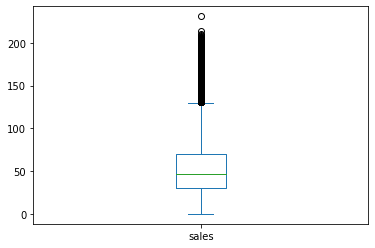

In [8]:
data[["date","sales"]].plot(kind='box')

In [16]:
# Setting the layout for our plot
layout = go.Layout(
    title='Stock Prices of Tesla',
    xaxis=dict(
        title='total_price',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    ),
    yaxis=dict(
        title='units_sold',
        titlefont=dict(
            family='Courier New, monospace',
            size=18,
            color='#7f7f7f'
        )
    )
)

_data = [{'x':data['total_price'], 'y':data['units_sold']}]
plot = go.Figure(data=_data, layout=layout)

In [17]:
iplot(plot)

In [19]:
data.rolling(7).mean().head(20)

,record_ID,store_id,sku_id,total_price,base_price,is_featured_sku,is_display_sku,units_sold
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,4.857143,8091.000000,217274.714286,165.910714,167.742857,0.000000,0.000000,32.571429
7,6.571429,8091.000000,218250.000000,181.891071,181.891071,0.000000,0.000000,36.857143
8,8.285714,8091.000000,219212.000000,194.919643,201.230357,0.142857,0.142857,44.571429
9,10.285714,8091.571429,219211.000000,189.932143,196.242857,0.142857,0.142857,56.000000


In [20]:
# Building the regression model
from sklearn.model_selection import train_test_split

#For preprocessing
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler

#For model evaluation
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import r2_score


In [21]:
#Split the data into train and test sets
X = np.array(data.index).reshape(-1,1)
Y = data['units_sold']
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.3, random_state=101)

In [22]:
# Feature scaling
scaler = StandardScaler().fit(X_train)

In [23]:
from sklearn.linear_model import LinearRegression

In [24]:
#Creating a linear model
lm = LinearRegression()
lm.fit(X_train, Y_train)

LinearRegression()

In [9]:
#Plot actual and predicted values for train dataset
trace0 = go.Scatter(
    x = X_train.T[0],
    y = Y_train,
    mode = 'markers',
    name = 'Actual'
)
trace1 = go.Scatter(
    x = X_train.T[0],
    y = lm.predict(X_train).T,
    mode = 'lines',
    name = 'Predicted'
)
_data = [trace0,trace1]
layout.xaxis.title.text = 'Day'
plot2 = go.Figure(data=_data, layout=layout)

NameError: name 'X_train' is not defined

In [27]:
iplot(plot2)

In [106]:
plot2